<a href="https://colab.research.google.com/github/quantumhome/DataAnalysisCaseStudy/blob/master/17thMay_WindEfficienyProject_Dev.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Wind Efficieny Project**

**Data Link: https://drive.google.com/file/d/1EBY8LrGvbOyI_gDNgNIMa_L9zMz56y7H/view?usp=drive_link**

**Agenda: Create a Regression model, we have to regress / forecast the target**

## **Step 1 - Requirement Phase**

#### **Configuration Libraries**

In [ ]:
import warnings
warnings.filterwarnings("ignore")

#### **Normal / Classical Libraries**

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

#### **Machine Learning Libraries**

In [ ]:
from sklearn.metrics import *
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, GridSearchCV

## **Step 2 - Data Ingestion**

### **Data Loading**

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/Datasets/wind_data.csv")

### **Data Inspection**

In [ ]:
df.head().style.set_properties(
    **{
        "background-color": "black",
        "color": "white",
        "border-color": "white",
        "border-width": "1px",
        "border-style": "solid",
    }
)

,timestamp,active_power_calculated_by_converter,active_power_raw,ambient_temperature,generator_speed,generator_winding_temp_max,grid_power10min_average,nc1_inside_temp,nacelle_temp,reactice_power_calculated_by_converter,reactive_power,wind_direction_raw,wind_speed_raw,wind_speed_turbulence,turbine_id,Target
0,2021-02-19 20:18:00,816.636759,834.917206,31.694380,1159.616602,65.954214,917.897085,31.881972,31.504713,141.457644,165.501518,280.864782,7.057000,0.544082,Turbine_108,47.582787
1,2021-04-27 04:55:00,419.107829,421.050873,12.894948,928.747996,59.571319,445.554250,32.423705,32.755770,89.186457,113.835236,299.552460,5.474937,0.469031,Turbine_18,46.070328
2,2021-01-25 06:26:00,1303.530558,1337.566142,16.648388,1201.219775,61.270498,1364.716003,11.446849,18.332985,230.622309,281.452253,84.960106,8.092457,0.622318,Turbine_105,39.989236
3,2021-10-30 03:47:00,61.494872,53.481008,28.388141,769.806122,40.674348,14.324897,34.253204,32.662889,66.211015,75.017531,87.261119,4.071032,0.760719,Turbine_15,46.056587
4,2021-03-15 00:39:00,593.514364,611.659108,31.519527,1046.916768,64.341763,599.020172,32.405586,31.466387,137.163938,160.202421,313.724818,6.357943,0.346068,Turbine_01,54.346095


### **Shape Inspection**

In [ ]:
print(f"Rows: {df.shape[0]} and Columns: {df.shape[1]}")

Rows: 909604 and Columns: 16


### **Gathering Information on the data**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 909604 entries, 0 to 909603
Data columns (total 16 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   timestamp                               909604 non-null  object 
 1   active_power_calculated_by_converter    909604 non-null  float64
 2   active_power_raw                        909604 non-null  float64
 3   ambient_temperature                     909604 non-null  float64
 4   generator_speed                         909604 non-null  float64
 5   generator_winding_temp_max              909604 non-null  float64
 6   grid_power10min_average                 909604 non-null  float64
 7   nc1_inside_temp                         909604 non-null  float64
 8   nacelle_temp                            909604 non-null  float64
 9   reactice_power_calculated_by_converter  909604 non-null  float64
 10  reactive_power                          9096

**INSIGHT**
  * **The data has no null values as per information, but the timestamp column is not in proper format**
  * **Target: `Target` Column**
  * **The `turbine_id` and `timestamp` are not so relevant (`timestamp` will be relevant if you are doing TSA)**

In [ ]:
# user_input = input("Enter the turbine_id: ")

# df[df["turbine_id"] == user_input]

### **Statistical Analysis**

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
active_power_calculated_by_converter,909604.0,525.886061,474.619576,0.000000,149.620898,379.989929,781.357475,1999.999858
active_power_raw,909604.0,537.639468,482.394907,0.000008,155.813244,383.985926,800.261108,1999.984456
ambient_temperature,909604.0,25.573921,8.025649,5.616541,17.093680,27.919035,32.171696,48.089017
generator_speed,909604.0,931.130882,193.674384,0.000000,770.538574,884.068502,1123.335856,1267.140625
generator_winding_temp_max,909604.0,60.730112,9.721582,25.636366,54.916767,60.034490,65.737187,129.846405
grid_power10min_average,909604.0,527.579537,472.656976,0.000000,147.181552,391.303187,794.875710,1999.991455
nc1_inside_temp,909604.0,31.755823,3.929794,11.141922,29.913803,31.762946,33.469745,52.790030
nacelle_temp,909604.0,31.686413,3.554426,16.010218,30.267423,31.961610,33.546260,48.406106
reactice_power_calculated_by_converter,909604.0,111.080610,78.219944,-318.393721,81.540850,92.005826,124.879153,523.892695
reactive_power,909604.0,133.692333,91.232152,-5.461607,96.045765,107.633378,154.153730,592.815938


<Axes: xlabel='Target', ylabel='Density'>

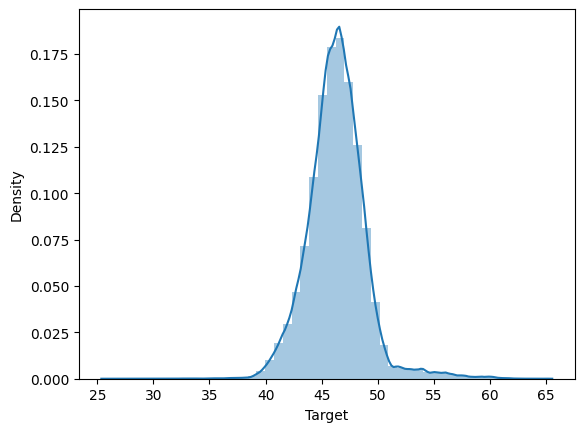

In [ ]:
sns.distplot(df["Target"])

## **Step 3 - Data Preprocecssing or Data Wrangling**

### **Null Values**

In [ ]:
df.isnull().sum()

,0
timestamp,0
active_power_calculated_by_converter,0
active_power_raw,0
ambient_temperature,0
generator_speed,0
generator_winding_temp_max,0
grid_power10min_average,0
nc1_inside_temp,0
nacelle_temp,0
reactice_power_calculated_by_converter,0


### **Duplicates**

In [ ]:
df.duplicated().sum()

np.int64(0)

### **Outlier Detection**

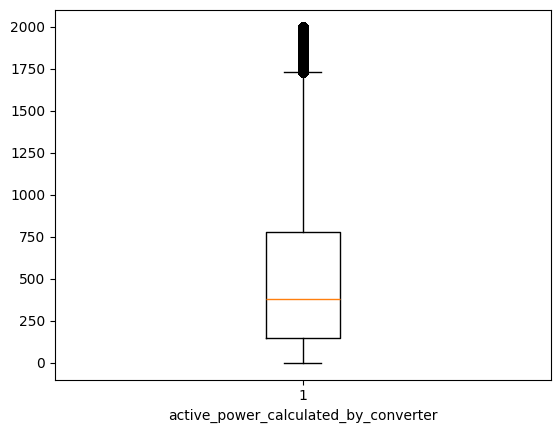

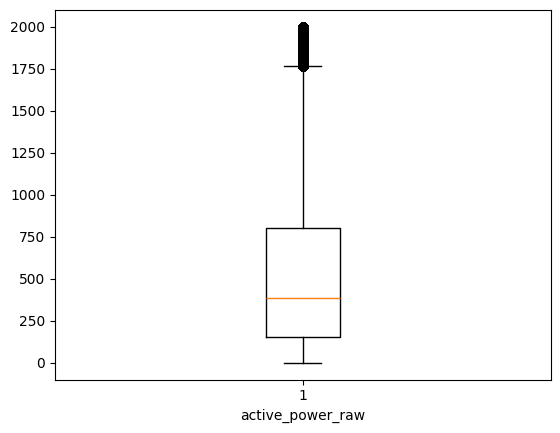

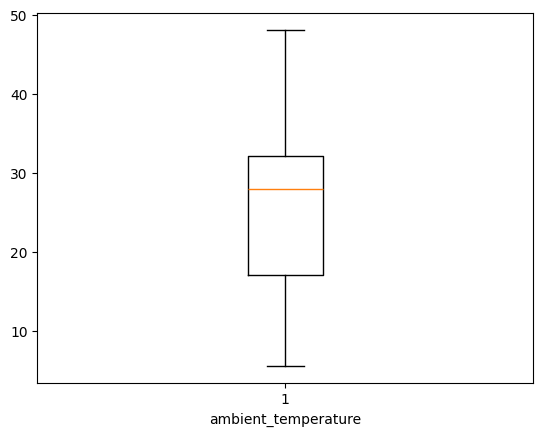

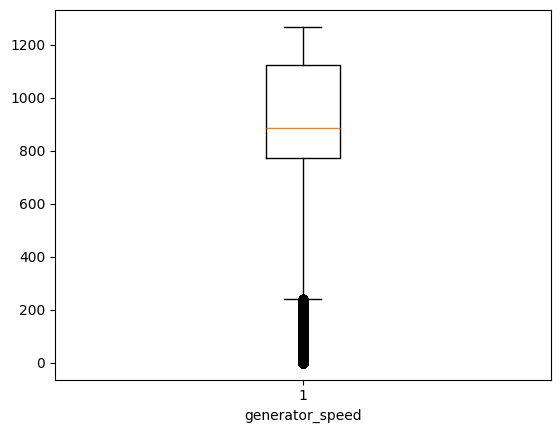

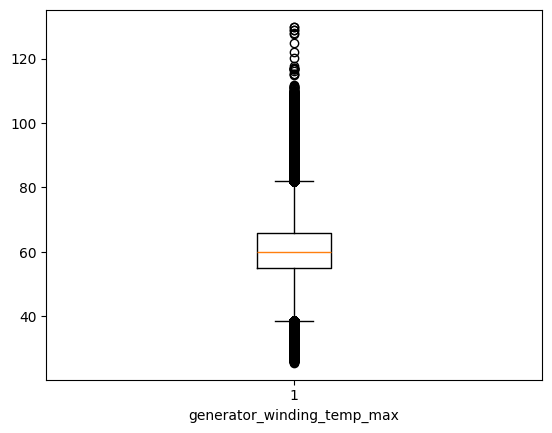

...

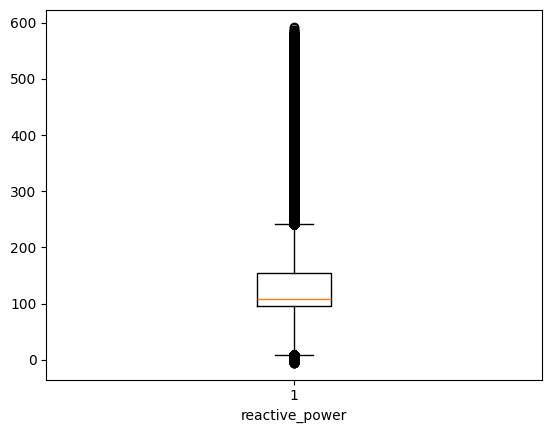

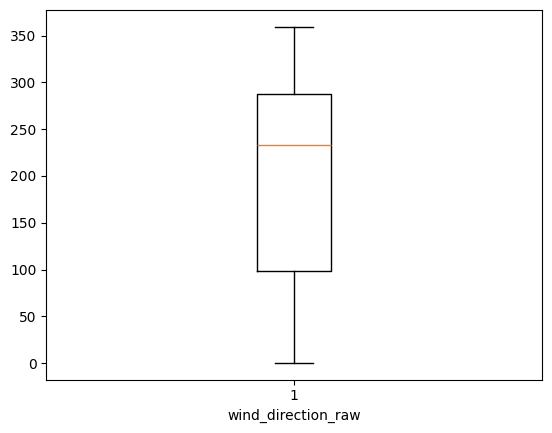

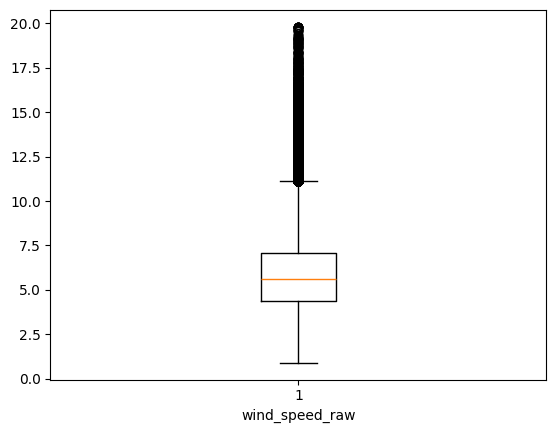

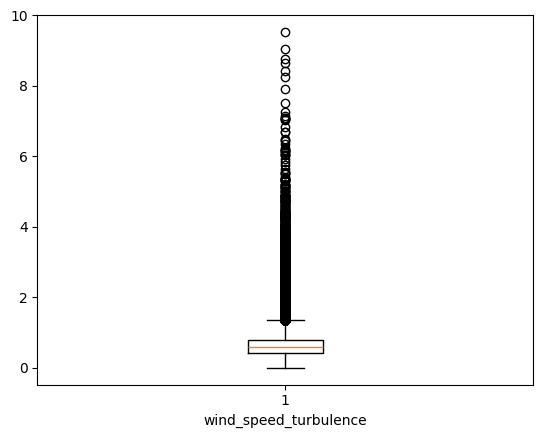

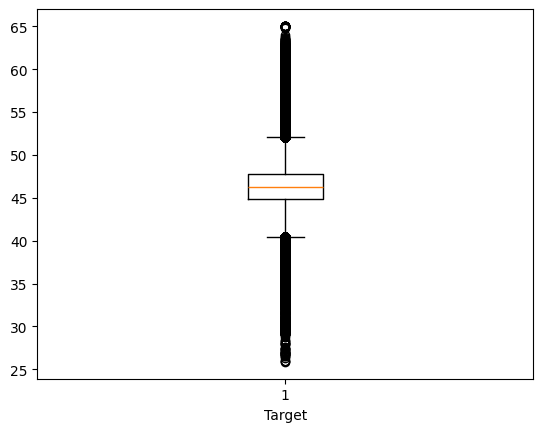

In [ ]:
for x in df.columns:
  if df[x].dtype != "object":
    plt.boxplot(df[x])
    plt.xlabel(x)
    plt.show()

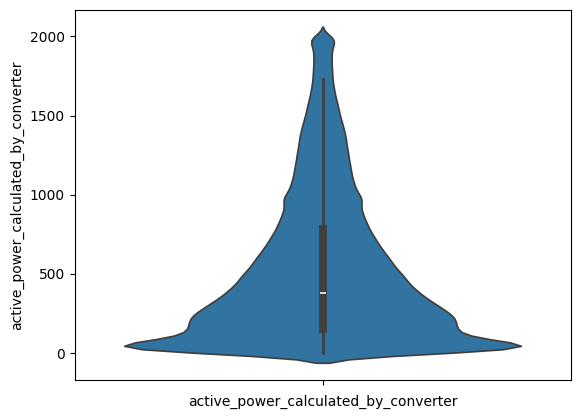

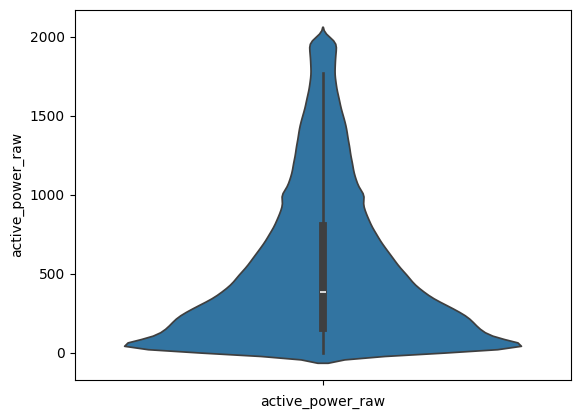

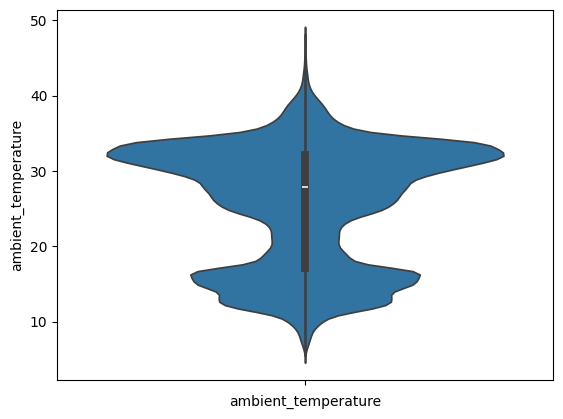

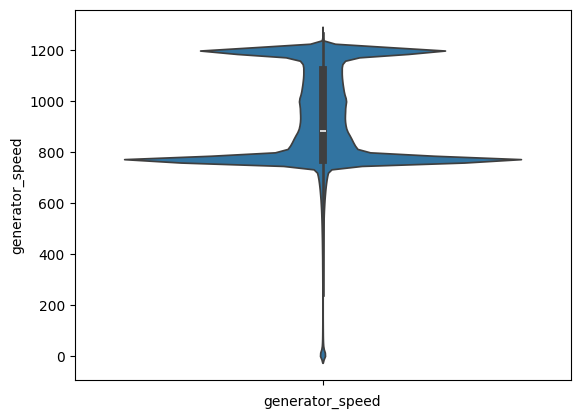

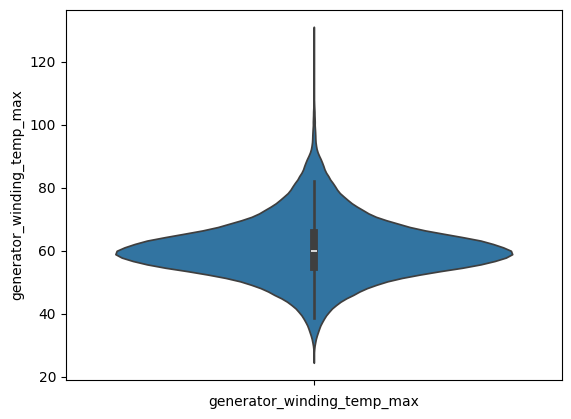

...

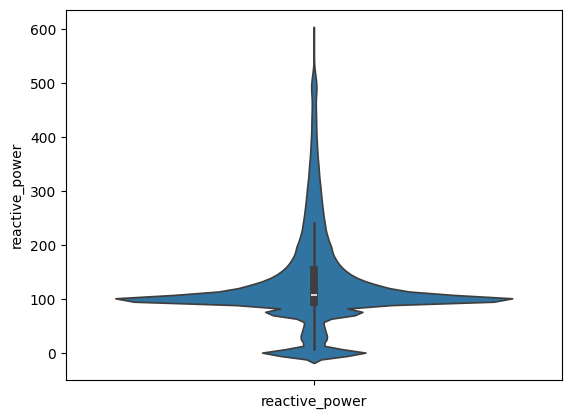

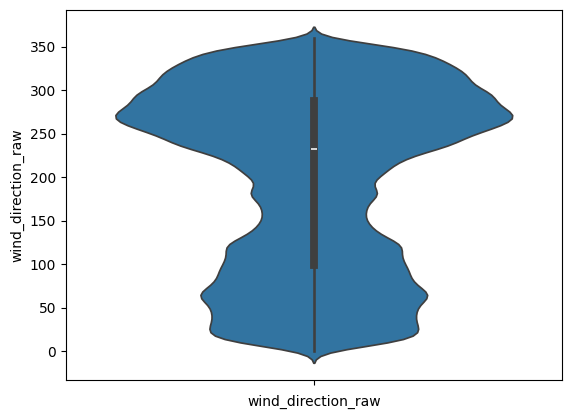

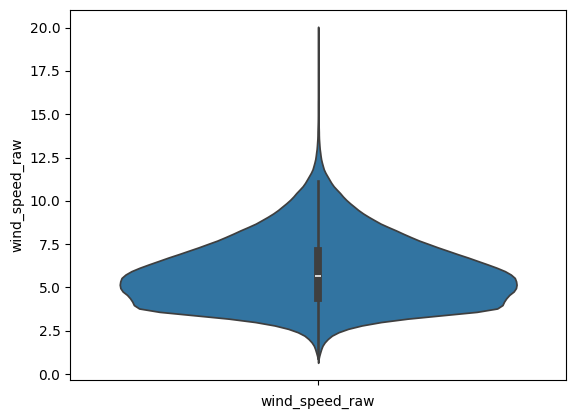

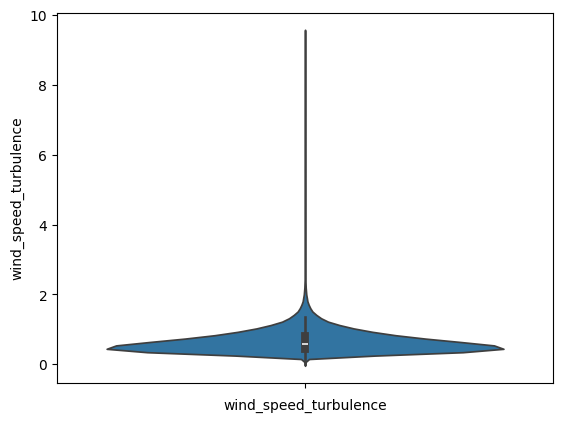

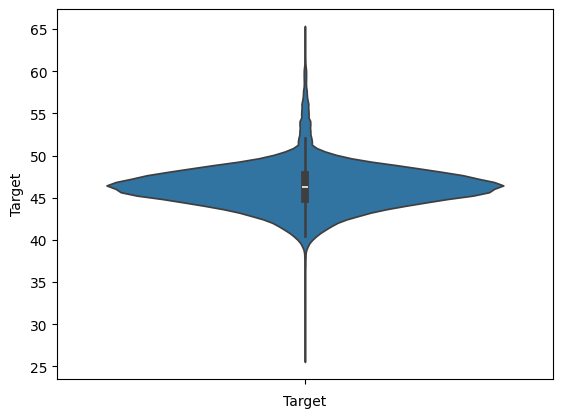

In [ ]:
for x in df.columns:
  if df[x].dtype != "object":
    sns.violinplot(df[x])
    plt.xlabel(x)
    plt.show()

In [ ]:
# import plotly.express as px
# for x in df.columns:
#   if df[x].dtype != "object":
#     fig = px.box(df[x])
#     fig.show()

In [ ]:
import plotly.express as px
fig = px.box(df["Target"])
fig.show()

### **Eliminate the outliers**

In [ ]:
df_copy = df.copy() # Candidate updates

In [ ]:
# IQR Technique
for columns in df_copy.columns:
  if df_copy[columns].dtype != "object":
    # Calculate the Q1 and Q3
    Q1 = df_copy[columns].quantile(0.25)
    Q3 = df_copy[columns].quantile(0.75)

    # Define IQR (Q3 - Q1)
    IQR = Q3 - Q1

    # Define your UB & LB
    UB = Q3 + (1.5 * IQR)
    LB = Q1 - (1.5 * IQR)

    # Eliminate
    df_copy = df_copy[(df_copy[columns]>=LB) & (df_copy[columns]<=UB)]

### **Convert the timestamp into time object**

In [ ]:
# df_copy["timestamp"] = pd.to_datetime(df_copy["timestamp"])

In [ ]:
# df_copy.index = df_copy.set_index(df_copy["timestamp"])

## **Step 4 - Feature Scaling**

In [ ]:
# Intialize the scaler object
scaler = StandardScaler()

In [ ]:
# Before standardizing the data, let's bifurcate the features and target column
x = df_copy.drop(["turbine_id", "timestamp", "Target"], axis = 1)

In [ ]:
# Target Columns
y = df_copy["Target"]

#### **Scaling the values**

In [ ]:
x = scaler.fit_transform(x)

## **Step 5 - Dimensionality Reduction**

In [ ]:
pca = PCA(n_components = 0.95) # Amount of variance to be captured

In [ ]:
pca_data = pca.fit_transform(x)

In [ ]:
pd.DataFrame(pca_data)

,0,1,2,3,4,5,6,7
0,5.215314,-0.110560,1.230518,-0.215669,-0.208045,1.359048,-0.801458,-0.032885
1,0.381406,-0.306867,0.157268,-0.635969,1.428312,-0.886064,-0.864868,0.198971
2,-3.535261,0.236062,-0.318291,1.782388,0.614295,-0.281053,2.459542,0.847856
3,1.037661,0.809024,-2.875114,0.065842,0.121341,-0.360547,0.267327,-0.178836
4,1.152829,0.554915,-0.228267,-1.161503,-0.035358,-1.724472,1.220054,-0.501658
...,...,...,...,...,...,...,...,...
497523,0.545563,0.152281,-0.029767,0.115955,-1.565388,0.192590,0.084938,0.422235
497524,-2.654300,-1.519122,0.569409,2.013432,0.054861,-0.372953,0.670057,0.389436
497525,-2.250649,-0.634164,-0.170025,0.118384,-1.299281,0.355239,0.874954,-0.511947
497526,4.421789,1.971166,-4.647113,0.647838,0.259038,-0.861409,0.135150,1.264082


## **Step 6 - Modelling Phase**

### **Splitting the data**

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(pca_data, y, test_size = 0.25, random_state = 43)

### **Linear Regression**

In [ ]:
# initializing the model
lr_model = LinearRegression()

In [ ]:
# Fit the data into the model
lr_model.fit(x_train, y_train)

LinearRegression()

In [ ]:
# Predictions
pred = lr_model.predict(x_test)

In [ ]:
# Function to evaluate the model
def evaluation(actual_values, predicted_values, num_of_features):
  mse = mean_squared_error(actual_values, predicted_values)
  rmse = np.sqrt(mse)
  r2 = r2_score(actual_values, predicted_values)
  mape = mean_absolute_percentage_error(actual_values, predicted_values)
  # Adjusted R2
  number_of_observations = len(actual_values) # Total number of records
  p = num_of_features # No of columns (after PCA)
  adjusted_r2_score = 1 - (1 - r2) * (number_of_observations - 1) / (number_of_observations - p - 1)
  print(f"Ajusted R2 Score: {adjusted_r2_score}")
  print(f"MSE: {mse}")
  print(f"RMSE: {rmse}")
  print(f"R2 Score: {r2}")
  print(f"MAPE: {mape}")

In [ ]:
num_of_features_after_pca = pca_data.shape[1]

In [ ]:
evaluation(y_test, pred, num_of_features_after_pca)

Ajusted R2 Score: 0.3570398045074693
MSE: 2.1312818076823774
RMSE: 1.4598910259613138
R2 Score: 0.35708115874617097
MAPE: 0.02445870056626809


### **Decision Tree Regressor**

In [ ]:
dt_regressor = DecisionTreeRegressor()

In [ ]:
# Fit the data into the model
dt_regressor.fit(x_train, y_train)

DecisionTreeRegressor()

In [ ]:
pred = dt_regressor.predict(x_test)

In [ ]:
evaluation(y_test, pred, num_of_features_after_pca)

Ajusted R2 Score: 0.2838410522946222
MSE: 2.373920730013774
RMSE: 1.5407532995303868
R2 Score: 0.28388711456765137
MAPE: 0.023686848344853264


### **Random Forest Regressor**

In [ ]:
rf_regressor = RandomForestRegressor()
rf_regressor.fit(x_train, y_train)
pred = rf_regressor.predict(x_test)
evaluation(y_test, pred, num_of_features_after_pca)

KeyboardInterrupt: 

### **Hyper Parameter Tuning - RFR**

In [ ]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}


In [ ]:
# Initialize GridSearchCV with the RandomForestRegressor
grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=3, n_jobs=-1, scoring='neg_mean_squared_error')

In [ ]:
# Fit GridSearchCV to the training data
grid_search.fit(x_train, y_train)

In [ ]:
# Print the best parameters found by GridSearchCV
print("Best parameters found: ", grid_search.best_params_)

In [ ]:
# Get the best model
best_rf_model = grid_search.best_estimator_

In [ ]:
# Make predictions with the best model
pred_best_rf = best_rf_model.predict(x_test)

In [ ]:
# Evaluate the best model
print("\nEvaluation of the best RandomForestRegressor model:")
evaluation(y_test, pred_best_rf, num_of_features_after_pca)


https://drive.google.com/file/d/1wrh_rzuoI1HFpqzrMK7YMdkq0mjhLcEc/view?usp=drive_link

In [ ]:
!pip install pycaret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 2.3 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of category-encoders to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.1/486.1 kB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.8/21.8 MB 34.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.4/85.4 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.2/302.2 kB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 33.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/1

In [ ]:
from pycaret.regression import setup, compare_models

setup(data = df_copy, target = 'Target', session_id = 123)

best_model = compare_models()

NameError: name 'df_copy' is not defined

In [ ]:
def remove_outliers_zscore(df, column, threshold=3):
    z_scores = np.abs((df[column] - df[column].mean()) / df[column].std())
    df_cleaned = df[z_scores < threshold].copy()
    return df_cleaned

df_copy_zscore = remove_outliers_zscore(df_copy, 'Target')

print(f"Shape before Z-score outlier removal: {df_copy.shape}")
print(f"Shape after Z-score outlier removal on Target: {df_copy_zscore.shape}")

